## To run:
- Data Cleaning Pipeline
- Train Test Split
- Testing

TODO: Check if tuning or stacking helps

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb

In [2]:
comp_data = pd.read_csv("train.csv" ).drop('id', axis=1)
original_data = pd.read_csv('horse.csv')
all_train = pd.concat([comp_data,original_data],ignore_index=True)
all_train = all_train.drop_duplicates()

all_train

,surgery,age,hospital_number,rectal_temp,pulse,respiratory_rate,temp_of_extremities,peripheral_pulse,mucous_membrane,capillary_refill_time,...,packed_cell_volume,total_protein,abdomo_appearance,abdomo_protein,surgical_lesion,lesion_1,lesion_2,lesion_3,cp_data,outcome
0,yes,adult,530001,38.1,132.0,24.0,cool,reduced,dark_cyanotic,more_3_sec,...,57.0,8.5,serosanguious,3.4,yes,2209,0,0,no,died
1,yes,adult,533836,37.5,88.0,12.0,cool,normal,pale_cyanotic,more_3_sec,...,33.0,64.0,serosanguious,2.0,yes,2208,0,0,no,euthanized
2,yes,adult,529812,38.3,120.0,28.0,cool,reduced,pale_pink,less_3_sec,...,37.0,6.4,serosanguious,3.4,yes,5124,0,0,no,lived
3,yes,adult,5262541,37.1,72.0,30.0,cold,reduced,pale_pink,more_3_sec,...,53.0,7.0,cloudy,3.9,yes,2208,0,0,yes,lived
4,no,adult,5299629,38.0,52.0,48.0,normal,normal,normal_pink,less_3_sec,...,47.0,7.3,cloudy,2.6,no,0,0,0,yes,lived
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1529,yes,adult,533886,NaN,120.0,70.0,cold,NaN,pale_cyanotic,more_3_sec,...,55.0,65.0,NaN,NaN,no,3205,0,0,no,euthanized
1530,no,adult,527702,37.2,72.0,24.0,cool,increased,pale_cyanotic,more_3_sec,...,44.0,NaN,serosanguious,3.3,yes,2208,0,0,yes,euthanized
1531,yes,adult,529386,37.5,72.0,30.0,cold,reduced,pale_cyanotic,less_3_sec,...,60.0,6.8,NaN,NaN,yes,3205,0,0,no,died
1532,yes,adult,530612,36.5,100.0,24.0,cool,reduced,pale_pink,less_3_sec,...,50.0,6.0,serosanguious,3.4,yes,2208,0,0,yes,lived


In [3]:
all_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1531 entries, 0 to 1533
Data columns (total 28 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   surgery                1531 non-null   object 
 1   age                    1531 non-null   object 
 2   hospital_number        1531 non-null   int64  
 3   rectal_temp            1471 non-null   float64
 4   pulse                  1507 non-null   float64
 5   respiratory_rate       1473 non-null   float64
 6   temp_of_extremities    1436 non-null   object 
 7   peripheral_pulse       1402 non-null   object 
 8   mucous_membrane        1463 non-null   object 
 9   capillary_refill_time  1493 non-null   object 
 10  pain                   1432 non-null   object 
 11  peristalsis            1467 non-null   object 
 12  abdominal_distention   1452 non-null   object 
 13  nasogastric_tube       1348 non-null   object 
 14  nasogastric_reflux     1404 non-null   object 
 15  nasogastr

In [4]:
all_train.isna().sum()

surgery                    0
age                        0
hospital_number            0
rectal_temp               60
pulse                     24
respiratory_rate          58
temp_of_extremities       95
peripheral_pulse         129
mucous_membrane           68
capillary_refill_time     38
pain                      99
peristalsis               64
abdominal_distention      79
nasogastric_tube         183
nasogastric_reflux       127
nasogastric_reflux_ph    246
rectal_exam_feces        292
abdomen                  329
packed_cell_volume        29
total_protein             33
abdomo_appearance        213
abdomo_protein           198
surgical_lesion            0
lesion_1                   0
lesion_2                   0
lesion_3                   0
cp_data                    0
outcome                    0
dtype: int64

### Data Cleaning Pipeline
- from EDA: 
     - dropped lesion_3
     - FE lesion_2
- based on data desc: 
    - FE lesion_1, mucous membrane, rectal_temp
    - dropped cp_data, hospital_number

- Fill nulls

In [5]:
# Mapping dictionaries
site_of_lesion = {
    '1': 'Gastric', '2': 'Small Intestine', '3': 'Large Colon', '4': 'Large Colon and Cecum', 
    '5': 'Cecum', '6': 'Transverse Colon', '7': 'Rectum/Descending Colon', '8': 'Uterus', 
    '9': 'Bladder', '11': 'All Intestinal Sites', '00': 'None'
}

type_mapping = {
    '1': 'Simple', '2': 'Strangulation', '3': 'Inflammation', '4': 'Other'
}

subtype_mapping = {
    '1': 'Mechanical', '2': 'Paralytic', '0': 'N/A'
}

specific_code = {
    '1': 'Obturation', '2': 'Intrinsic', '3': 'Extrinsic', '4': 'Adynamic', '5': 'Volvulus/Torsion',
    '6': 'Intussuption', '7': 'Thromboembolic', '8': 'Hernia', '9': 'Lipoma/Splenic Incarceration',
    '10': 'Displacement', '0': 'N/A'
}

# Function to categorize a number
def categorize_number(number):
    if number == 0:
        return 0,-1,-1,-1
    num_str = str(number)  # Pad with zeros if needed
    if len(num_str) == 5:
        flag = 0
        if num_str[:2] in site_of_lesion:
            lesion_code = num_str[:2]  # 2-digit Site of Lesion
            if num_str[2] in type_mapping:
                type_code = num_str[2]  # Next digit is Type
                if num_str[3] in subtype_mapping:
                    subtype_code = num_str[3]  # Fourth digit is Subtype
                    if num_str[4] in specific_code:
                        specific_code_value = num_str[4]  # Last digit is Specific Code
                        flag = 1
        
        if flag == 0:
            lesion_code = num_str[0]  # 1-digit Site of Lesion
            type_code = num_str[1]  # Second digit is Type
            subtype_code = num_str[2]  # Third digit is Subtype
            specific_code_value = num_str[3:]  # Last two digits are Specific Code

    elif len(num_str) == 4:
        lesion_code = num_str[0]  # 1-digit Site of Lesion
        type_code = num_str[1]  # Second digit is Type
        subtype_code = num_str[2]  # Third digit is Subtype
        specific_code_value = num_str[3]  # Last two digits are Specific Code

    elif len(num_str) == 6:
        lesion_code = num_str[:2]  # 1-digit Site of Lesion
        type_code = num_str[2]  # Second digit is Type
        subtype_code = num_str[3]  # Third digit is Subtype
        specific_code_value = num_str[4:]  # Last two digits are Specific Code

    elif len(num_str) == 3:
        lesion_code = "00"  # 1-digit Site of Lesion
        type_code = num_str[0]  # Second digit is Type
        subtype_code = num_str[1]  # Third digit is Subtype
        specific_code_value = num_str[2]  # Last two digits are Specific Code
    
    else:
        return -1,-1,-1,-1

    lesion = int(lesion_code) if lesion_code in site_of_lesion else -1 
    lesion_type = int(type_code) if type_code in type_mapping else -1 
    subtype = int(subtype_code) if subtype_code in subtype_mapping else -1
    specific = int(specific_code_value) if specific_code_value in specific_code else -1


    return (lesion, lesion_type, subtype, specific)

In [6]:
def lesion_1_transform(X):
    X[['Site of Lesion', 'Type', 'Subtype', 'Specific Code']] = X.apply(lambda x: categorize_number(x['lesion_1']), axis = 1).tolist()
    return X


In [7]:
all_train[[i for i in all_train.columns if all_train[i].isna().any()]].mode()

,rectal_temp,pulse,respiratory_rate,temp_of_extremities,peripheral_pulse,mucous_membrane,capillary_refill_time,pain,peristalsis,abdominal_distention,nasogastric_tube,nasogastric_reflux,nasogastric_reflux_ph,rectal_exam_feces,abdomen,packed_cell_volume,total_protein,abdomo_appearance,abdomo_protein
0,38.0,48.0,24.0,cool,reduced,pale_pink,less_3_sec,depressed,hypomotile,moderate,slight,more_1_liter,2.0,absent,distend_small,57.0,7.5,serosanguious,2.0


either filled categorical with "normal" or mode. "normal" performed better

In [8]:
from sklearn.impute import KNNImputer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder, OrdinalEncoder, MinMaxScaler, FunctionTransformer
from sklearn.base import BaseEstimator, TransformerMixin


def lesion_2_transform(X):
    X["lesion_2"] = np.where( X["lesion_2"]==0,0, 1)

    return X


def custom_ordinal_encoder(X):
    
    X["peristalsis"] = X["peristalsis"].replace('distend_small', 'normal')
    X["rectal_exam_feces"] = X["rectal_exam_feces"].replace('serosanguious', 'absent')
    X["nasogastric_reflux"] = X["nasogastric_reflux"].replace('slight', 'less_1_liter')

    X["temp_of_extremities"] = X["temp_of_extremities"].fillna("normal").map({'cold': 0, 'cool': 1, 'normal': 2, 'warm': 3})
    X["peripheral_pulse"] = X["peripheral_pulse"].fillna("normal").map({'absent': 0, 'reduced': 1, 'normal': 2, 'increased': 3})
    X["capillary_refill_time"] = X["capillary_refill_time"].fillna("3").map({'less_3_sec': 0, '3': 1, 'more_3_sec': 2})
    X["peristalsis"] = X["peristalsis"].fillna("normal").map({'hypermotile': 0, 'normal': 1, 'hypomotile': 2, 'absent': 3})
    X["abdominal_distention"] = X["abdominal_distention"].fillna("none").map({'none': 0, 'slight': 1, 'moderate': 2, 'severe': 3})
    X["nasogastric_tube"] = X["nasogastric_tube"].fillna("none").map({'none': 0, 'slight': 1, 'significant': 2})
    X["nasogastric_reflux"] = X["nasogastric_reflux"].fillna("none").map({'none': 0, 'less_1_liter': 1, 'more_1_liter': 2})
    X["rectal_exam_feces"] = X["rectal_exam_feces"].fillna("normal").map({'absent': 0, 'decreased': 1, 'normal': 2, 'increased': 3})
    X["abdomen"] = X["abdomen"].fillna("normal").map({'normal': 0, 'other': 1, 'firm': 2,'distend_small': 3, 'distend_large': 4})
    X["abdomo_appearance"] = X["abdomo_appearance"].fillna("serosanguious").map({'clear': 0, 'cloudy': 1, 'serosanguious': 2})
   
    return X


lesion_2_transformer = FunctionTransformer(lesion_2_transform)
custom_ordinal_encode = FunctionTransformer(custom_ordinal_encoder)


drop_features = ['lesion_3', 'rectal_temp', "cp_data", "hospital_number"]


cat_var = ['surgery',
            'age',
            'temp_of_extremities',
            'peripheral_pulse',
            'mucous_membrane',
            'capillary_refill_time',
            'pain',
            'peristalsis',
            'abdominal_distention',
            'nasogastric_tube',
            'nasogastric_reflux',
            'rectal_exam_feces',
            'abdomen',
            'abdomo_appearance',
            'surgical_lesion',
            ]  + ['lesion_2'] + ['Site of Lesion', 'Type', 'Subtype', 'Specific Code']

binary_cat_var = ["surgery", "age", "surgical_lesion"] 
ord_cat_var = ["temp_of_extremities", "peripheral_pulse", "capillary_refill_time", 
           "nasogastric_tube", "nasogastric_reflux", "rectal_exam_feces",
        ] + ['peristalsis', 'abdominal_distention', 'abdomen', 'abdomo_appearance',] + ['Site of Lesion', 'Type', 'Subtype', 'Specific Code'] 
others_cat_var = [ "pain", "mucous_membrane"]


num_var = [
            'pulse',
            'respiratory_rate',
            'nasogastric_reflux_ph',
            'packed_cell_volume',
            'total_protein',
            'abdomo_protein',      
            'deviation_rectal_temp',
           
            ]

# Preprocessing for numerical data
numerical_transformer = Pipeline(steps=[
    ('impute', KNNImputer( n_neighbors=10)),
    ('scaler', StandardScaler()),
])

# Preprocessing for ordinal categorical data
ord_categorical_transformer = Pipeline(steps=[
    ('ord', custom_ordinal_encode),

])


# Preprocessing for binary categorical data
binary_categorical_transformer = Pipeline(steps=[
    ("binary", OrdinalEncoder()),

])

# Preprocessing for non-binary categorical data
others_categorical_transformer = Pipeline(steps=[
    ("others", OneHotEncoder(handle_unknown="ignore"))

])


updated_preprocessor = ColumnTransformer(
    transformers=[
        ('lesion2', lesion_2_transformer, ["lesion_2"]),
        ('num', numerical_transformer, num_var),
        ('ord', ord_categorical_transformer, ord_cat_var),
        ('binary', binary_categorical_transformer, binary_cat_var),
        ('others', others_categorical_transformer, others_cat_var)
        ],
)




### Train Test Split

In [9]:
train_data = all_train
train_data['deviation_rectal_temp'] = np.abs(train_data['rectal_temp']-37.8)
train_data[['Site of Lesion', 'Type', 'Subtype', 'Specific Code']] = train_data.apply(lambda x: categorize_number(x['lesion_1']), axis = 1).tolist()


In [10]:
from sklearn.model_selection import train_test_split
target = "outcome"
X= train_data[num_var+cat_var]
y = train_data[target]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y , test_size = 0.2, random_state=42, stratify=y)
ytrain = pd.Series(ytrain).map({'died': 0, 'euthanized': 1, 'lived': 2})
ytest = pd.Series(ytest).map({'died': 0, 'euthanized': 1, 'lived': 2})


In [11]:
ytrain.value_counts()

outcome
2    601
0    389
1    234
Name: count, dtype: int64

### Modelling

In [19]:
def evaluate(clf_pipe, Xtrain, Xtest, ytrain, ytest):
    from sklearn.metrics import confusion_matrix
    from sklearn.metrics import classification_report
    from sklearn.metrics import f1_score

    # Predict Legendary values corresponding to Total
    train_pred = clf_pipe.predict(Xtrain)
    test_pred = clf_pipe.predict(Xtest)

    # Check the Goodness of Fit (on Train Data)
    print("Goodness of Fit of Model \tTrain Dataset")
    #print("Classification Accuracy \t:", clf_pipe.score(Xtrain, ytrain))
    print("F1 Score \t:", f1_score(ytrain, train_pred, average="micro"))
    print()

    # Check the Goodness of Fit (on Test Data)
    print("Goodness of Fit of Model \tTest Dataset")
    #print("Classification Accuracy \t:", clf_pipe.score(Xtest, ytest))
    print("F1 Score \t:", f1_score(ytest, test_pred, average="micro"))
    print(classification_report(ytest, test_pred))
    print()

 
    order = [0,1,2]

    
    f, axes = plt.subplots(1, 2, figsize=(12, 4))
    sb.heatmap(confusion_matrix(ytrain, train_pred, labels=order),
            annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0], xticklabels=order, yticklabels=order)
    sb.heatmap(confusion_matrix(ytest, test_pred, labels=order), 
            annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1], xticklabels=order, yticklabels=order)
    
    

#### Compare Base

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000486 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 529
[LightGBM] [Info] Number of data points in the train set: 1224, number of used features: 37
[LightGBM] [Info] Start training from score -1.146300
[LightGBM] [Info] Start training from score -1.654558
[LightGBM] [Info] Start training from score -0.711285
Goodness of Fit of Model 	Train Dataset
F1 Score 	: 1.0

Goodness of Fit of Model 	Test Dataset
F1 Score 	: 0.745928338762215
              precision    recall  f1-score   support

           0       0.73      0.72      0.73        97
           1       0.74      0.53      0.61        59
           2       0.76      0.85      0.80       151

    accuracy                           0.75       307
   macro avg       0.74      0.70      0.71       307
weighted avg       0.74      0.75      0.74       307


Goodness of Fit of Model 	Train Dataset
F1 

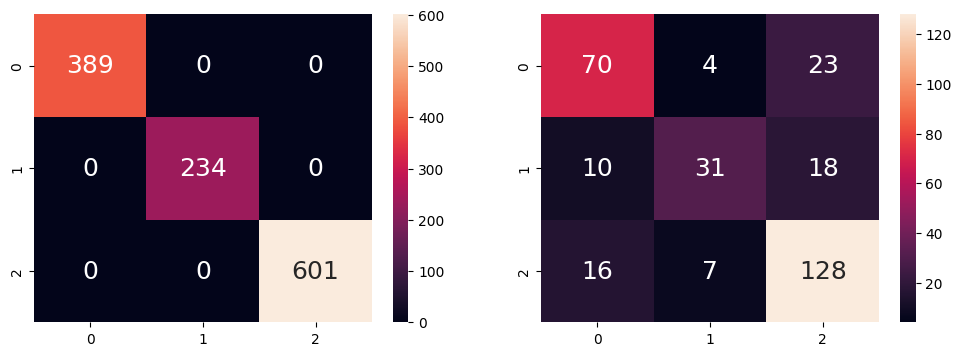

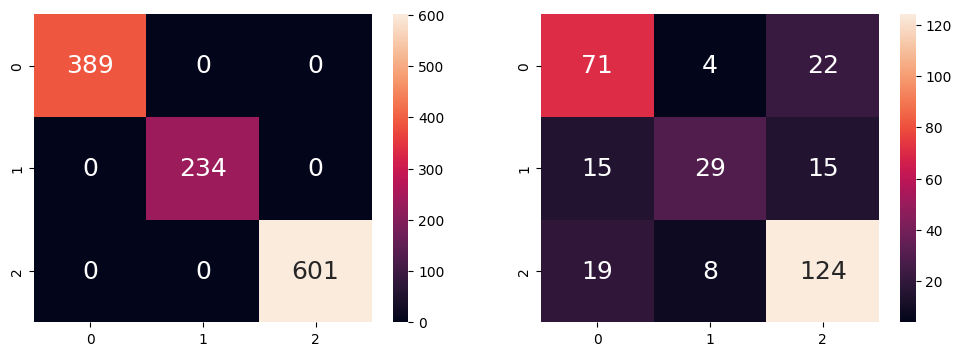

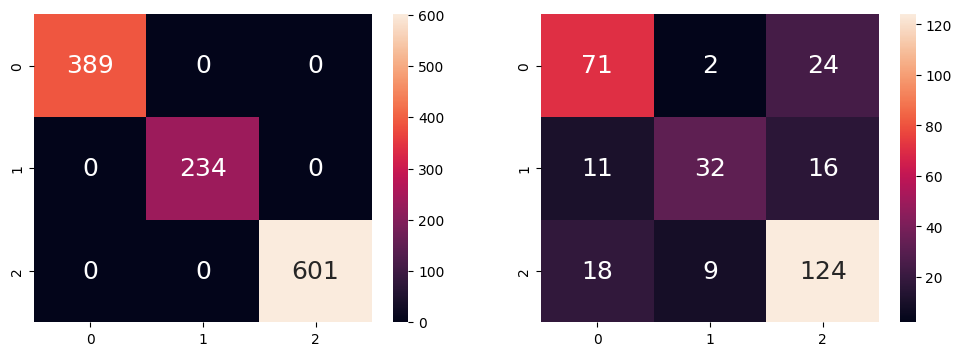

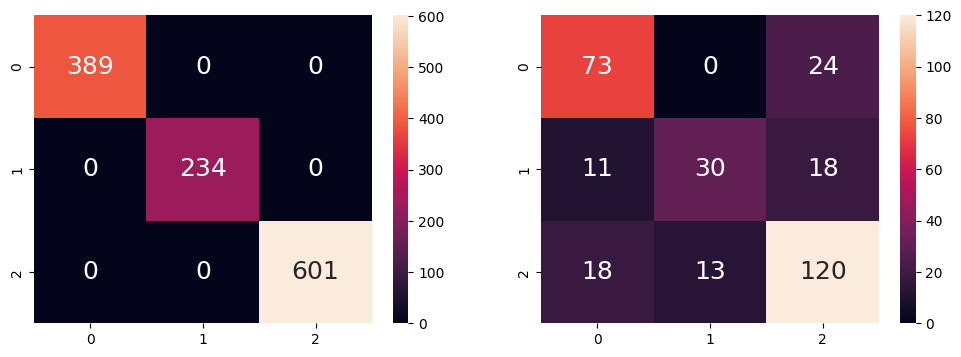

In [20]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
#RandomForestClassifier,DecisionTreeClassifier
train_predictions = pd.DataFrame()
test_predictions = pd.DataFrame()
for model in [LGBMClassifier, XGBClassifier, CatBoostClassifier, RandomForestClassifier]:
    clf = model()
    clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor),
                                ('model', clf)
                                ])
    clf_pipe.fit(Xtrain, ytrain)
    name = str(model).split('.')[-1][:-2]
    if name == "CatBoostClassifier":
        train_predictions[name] = clf_pipe.predict(Xtrain).ravel()
        test_predictions[name] = clf_pipe.predict(Xtest).ravel()
    else:
        train_predictions[name] = clf_pipe.predict(Xtrain)
        test_predictions[name] = clf_pipe.predict(Xtest)
    train_predictions[name+"_prob"] = list(clf_pipe.predict_proba(Xtrain))
    test_predictions[name+"_prob"] = list(clf_pipe.predict_proba(Xtest))
    evaluate(clf_pipe, Xtrain, Xtest, ytrain, ytest)
train_predictions['actual'] = list(ytrain)
test_predictions['actual'] = list(ytest)


In [21]:
test_predictions[['LGBMClassifier', 'XGBClassifier', 'RandomForestClassifier',]].corr() # 'CatBoostClassifier'

,LGBMClassifier,XGBClassifier,RandomForestClassifier
LGBMClassifier,1.000000,0.892735,0.727086
XGBClassifier,0.892735,1.000000,0.759991
RandomForestClassifier,0.727086,0.759991,1.000000


<Axes: >

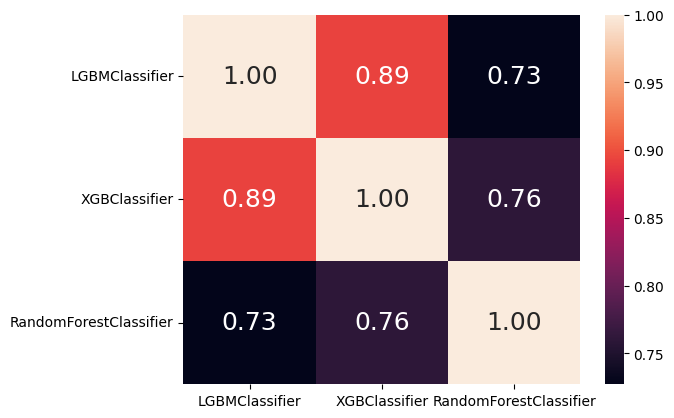

In [22]:
sb.heatmap(test_predictions[['LGBMClassifier', 'XGBClassifier', 'RandomForestClassifier', ]].corr(), #'CatBoostClassifier'
            annot = True, fmt=".2f", annot_kws={"size": 18})

### Tuning

Fitting 3 folds for each of 192 candidates, totalling 576 fits
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 455
[LightGBM] [Info] Number of data points in the train set: 816, number of used features: 37
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

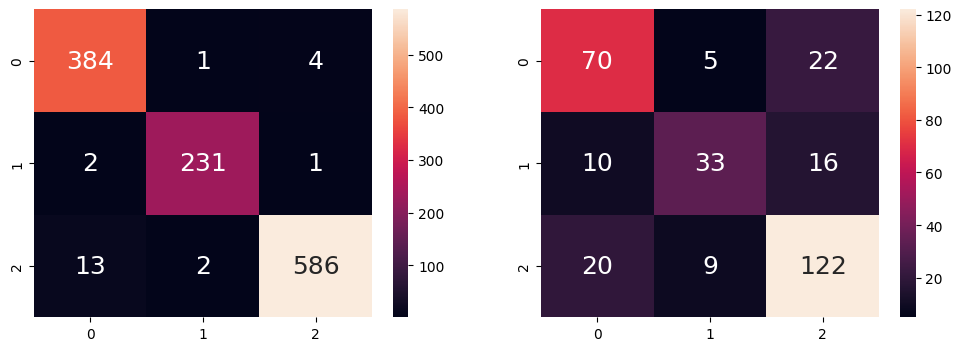

In [16]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, HistGradientBoostingClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression, ElasticNet
from sklearn.svm import SVC
from catboost import CatBoostClassifier



param_grid = {
    "model__n_estimators": np.arange(100,500,100),
    "model__max_depth": np.arange(3,7),
    "model__class_weight": ["balanced", None],
    'model__num_leaves': [50, 100, 150],
    'model__learning_rate': [ 0.05, 0.1],
}

processor = updated_preprocessor
clf = LGBMClassifier()


clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor),
                            ('model', clf)
                            ])

model = GridSearchCV(clf_pipe, param_grid=param_grid, cv = 3, verbose =5, scoring="f1_micro")
try:
    model.fit(Xtrain, ytrain)
except ValueError as e:
    print("ValueError during model fitting:", e)
except Exception as e:
    print("An error occurred during model fitting:", e)

lgb_best_estimator = model.best_estimator_
print(lgb_best_estimator)
print(evaluate(lgb_best_estimator, Xtrain, Xtest, ytrain, ytest))



Fitting 3 folds for each of 80 candidates, totalling 240 fits
[CV 1/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=300;, score=0.711 total time=   0.8s
[CV 2/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=300;, score=0.679 total time=   0.7s
[CV 3/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=300;, score=0.676 total time=   0.7s
[CV 1/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=400;, score=0.713 total time=   0.9s
[CV 2/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=400;, score=0.674 total time=   0.9s
[CV 3/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=400;, score=0.676 total time=   0.9s
[CV 1/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=500;, score=0.708 total time=   1.1s
[CV 2/3] END model__max_depth=3, model__min_samples_leaf=5, model__n_estimators=500;, score=0.689 total time=   1.2s
[C

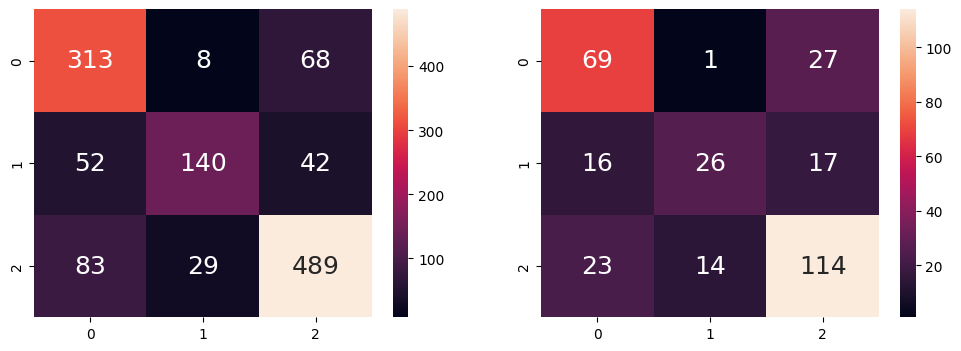

In [17]:


param_grid = {
    "model__n_estimators": np.arange(300,700,100),
    "model__max_depth": np.arange(3,7),
    'model__min_samples_leaf': np.arange(5,10),
}

processor = updated_preprocessor

clf = RandomForestClassifier()
balanced_clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor),
                            ('model', clf)
                            ])

model = GridSearchCV(balanced_clf_pipe, param_grid=param_grid, cv = 3, verbose =5, scoring="f1_micro")
try:
    model.fit(Xtrain, ytrain)
except ValueError as e:
    print("ValueError during model fitting:", e)
except Exception as e:
    print("An error occurred during model fitting:", e)

tree_best_estimator = model.best_estimator_
print(tree_best_estimator)

print(evaluate(tree_best_estimator, Xtrain, Xtest, ytrain, ytest))


In [18]:


param_grid = {
    "model__n_estimators": np.arange(100,500,100),
    "model__max_depth": np.arange(3,7),
    'model__learning_rate': [0.01, 0.05, 0.1],
    "model__min_child_weight" : np.arange(4,6,1)
}

processor = updated_preprocessor

clf = XGBClassifier()
balanced_clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor),
                            ('model', clf)
                            ])

model = GridSearchCV(balanced_clf_pipe, param_grid=param_grid, cv = 3, verbose =5, scoring="f1_micro")
try:
    model.fit(Xtrain, ytrain)
except ValueError as e:
    print("ValueError during model fitting:", e)
except Exception as e:
    print("An error occurred during model fitting:", e)

xgb_best_estimator = model.best_estimator_
print(xgb_best_estimator)

print(evaluate(xgb_best_estimator, Xtrain, Xtest, ytrain, ytest))



Fitting 3 folds for each of 96 candidates, totalling 288 fits
[CV 1/3] END model__learning_rate=0.01, model__max_depth=3, model__min_child_weight=4, model__n_estimators=100;, score=0.728 total time=   0.2s
[CV 2/3] END model__learning_rate=0.01, model__max_depth=3, model__min_child_weight=4, model__n_estimators=100;, score=0.689 total time=   0.2s
[CV 3/3] END model__learning_rate=0.01, model__max_depth=3, model__min_child_weight=4, model__n_estimators=100;, score=0.669 total time=   0.2s
[CV 1/3] END model__learning_rate=0.01, model__max_depth=3, model__min_child_weight=4, model__n_estimators=200;, score=0.728 total time=   0.3s
[CV 2/3] END model__learning_rate=0.01, model__max_depth=3, model__min_child_weight=4, model__n_estimators=200;, score=0.691 total time=   0.3s
[CV 3/3] END model__learning_rate=0.01, model__max_depth=3, model__min_child_weight=4, model__n_estimators=200;, score=0.676 total time=   0.2s
[CV 1/3] END model__learning_rate=0.01, model__max_depth=3, model__min_chi

KeyboardInterrupt: 

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV 1/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=100;, score=0.728 total time=   0.3s
[CV 2/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=100;, score=0.694 total time=   0.2s
[CV 3/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=100;, score=0.689 total time=   0.3s
[CV 1/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=200;, score=0.745 total time=   0.4s
[CV 2/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=200;, score=0.706 total time=   0.4s
[CV 3/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=200;, score=0.689 total time=   0.4s
[CV 1/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=300;, score=0.743 total time=   0.6s
[CV 2/3] END model__learning_rate=0.05, model__max_depth=3, model__n_estimators=300;, score=0.708 total time=   0.6s
[CV

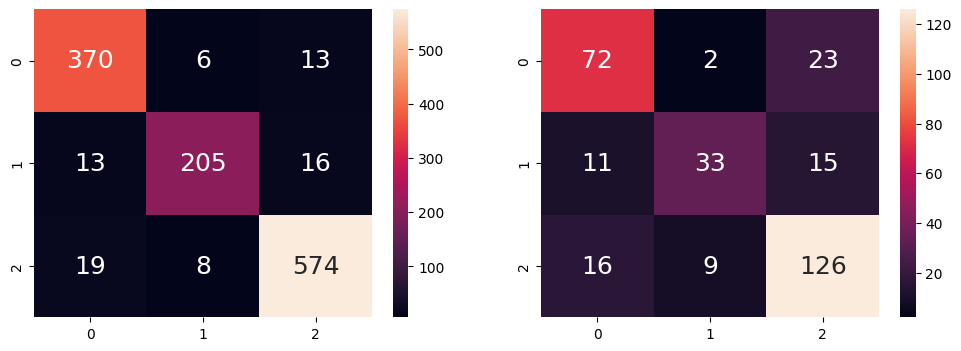

In [ ]:


param_grid = {
    "model__n_estimators": np.arange(100,500,100),
    "model__max_depth": np.arange(3,7),
    'model__learning_rate': [ 0.05, 0.1],
}

processor= updated_preprocessor

clf = CatBoostClassifier(silent=True)
balanced_clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor),
                            ('model', clf)
                            ])

model = GridSearchCV(balanced_clf_pipe, param_grid=param_grid, cv = 3, verbose =5, scoring="f1_micro")
try:
    model.fit(Xtrain, ytrain)
except ValueError as e:
    print("ValueError during model fitting:", e)
except Exception as e:
    print("An error occurred during model fitting:", e)

cat_best_estimator = model.best_estimator_
print(cat_best_estimator)
print(cat_best_estimator["model"].get_params())
print(evaluate(cat_best_estimator, Xtrain, Xtest, ytrain, ytest))



### Stacking

In [ ]:
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression, ElasticNet
from sklearn.svm import SVC
from catboost import CatBoostClassifier

estimators=[("xgb",XGBClassifier()), ("cat", RandomForestClassifier()),("lgb", LGBMClassifier())] 

clf =  StackingClassifier(estimators = estimators, stack_method="predict_proba", cv=3)

stacked_clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor),
                              ('model', clf)
                             ])

model =stacked_clf_pipe
try:
    model.fit(Xtrain, ytrain)
except ValueError as e:
    print("ValueError during model fitting:", e)
except Exception as e:
    print("An error occurred during model fitting:", e)

stacked_best_estimator = model
print(stacked_best_estimator)
print(evaluate(stacked_best_estimator, Xtrain, Xtest, ytrain, ytest))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 529
[LightGBM] [Info] Number of data points in the train set: 1224, number of used features: 37
[LightGBM] [Info] Start training from score -1.146300
[LightGBM] [Info] Start training from score -1.654558
[LightGBM] [Info] Start training from score -0.711285
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000173 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 465
[LightGBM] [Info] Number of data points in the train set: 816, number of used features: 37
[LightGBM] [Info] Start training from score -1.143733
[LightGBM] [Info] Start training from score -1.654558
[LightGBM] [Info] Start train

NameError: name 'evaluate' is not defined

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000472 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 529
[LightGBM] [Info] Number of data points in the train set: 1224, number of used features: 37
[LightGBM] [Info] Start training from score -1.146300
[LightGBM] [Info] Start training from score -1.654558
[LightGBM] [Info] Start training from score -0.711285
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

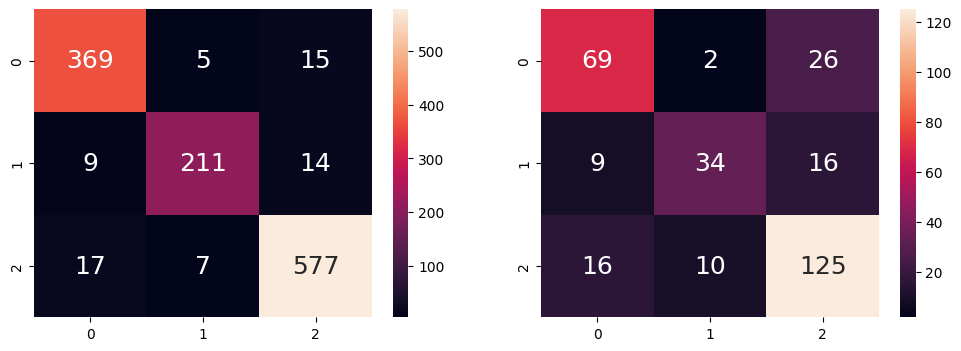

In [ ]:
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression, ElasticNet
from sklearn.svm import SVC
from catboost import CatBoostClassifier

estimators=[("xgb",xgb_best_estimator['model']), ("tree", tree_best_estimator['model']),("lgb",lgb_best_estimator['model'])] 

clf =  StackingClassifier(estimators = estimators, stack_method="predict_proba", cv=3)

stacked_clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor),
                              ('model', clf)
                             ])

model =stacked_clf_pipe
try:
    model.fit(Xtrain, ytrain)
except ValueError as e:
    print("ValueError during model fitting:", e)
except Exception as e:
    print("An error occurred during model fitting:", e)

stacked_tuned_best_estimator = model
print(stacked_tuned_best_estimator)
print(evaluate(stacked_tuned_best_estimator, Xtrain, Xtest, ytrain, ytest))


### Testing

In [ ]:
from lightgbm import LGBMClassifier
clf = LGBMClassifier()
clf_pipe = Pipeline(steps=[('preprocessor', updated_preprocessor), ('model', clf)])
clf_pipe.fit(Xtrain, ytrain)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000774 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 527
[LightGBM] [Info] Number of data points in the train set: 1224, number of used features: 36
[LightGBM] [Info] Start training from score -1.146300
[LightGBM] [Info] Start training from score -1.654558
[LightGBM] [Info] Start training from score -0.711285


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('lesion2',
                                                  FunctionTransformer(func=<function lesion_2_transform at 0x000001F91B343600>),
                                                  ['lesion_2']),
                                                 ('num',
                                                  Pipeline(steps=[('impute',
                                                                   KNNImputer(n_neighbors=10)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['pulse', 'respiratory_rate',
                                                   'nasogastric_reflux_ph',
                                                   'packed_cell_volume',
                                                   'total_protein',
                                                   'abdom...
                                                   'rectal_exam_feces',
                                                   'peristalsis',
                                                   'abdominal_distention',
                                                   'abdomen',
                                                   'abdomo_appearance',
                                                   'Site of Lesion', 'Type',
                                                   'Subtype',
                                                   'Specific Code']),
                                                 ('binary',
                                                  Pipeline(steps=[('binary',
                                                                   OrdinalEncoder())]),
                                                  ['surgery', 'age',
                                                   'surgical_lesion']),
                                                 ('others',
                                                  Pipeline(steps=[('others',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['pain',
                                                   'mucous_membrane'])])),
                ('model', LGBMClassifier())])

In [ ]:
submission_data = pd.read_csv("test.csv")
submission_data['deviation_rectal_temp'] = np.abs(submission_data['rectal_temp']-37.8)
submission_data[['Site of Lesion', 'Type', 'Subtype', 'Specific Code']] = submission_data.apply(lambda x: categorize_number(x['lesion_1']), axis = 1).tolist()

In [ ]:
submission_pred = clf_pipe.predict(submission_data) ##
submission_df = pd.DataFrame({"id":submission_data["id"], "outcome": submission_pred})
if submission_df['outcome'].dtype != object:
    submission_df['outcome'] = submission_df['outcome'].map({0:"died", 1:"euthanized", 2:'lived'})


In [ ]:
submission_df

,id,outcome
0,1235,lived
1,1236,died
2,1237,lived
3,1238,euthanized
4,1239,lived
...,...,...
819,2054,died
820,2055,euthanized
821,2056,died
822,2057,lived


In [ ]:
submission_df.to_csv("check6.csv", index=False)